In [3]:
import torch
torch.manual_seed(0)
import numpy as np
import matplotlib.pyplot as plt
import torchvision.models as models
from torchvision import transforms
from IPython.display import display
import PIL
from PIL import ImageFilter
from PIL import Image

device = "cuda" if torch.cuda.is_available() else "cpu"

## ImageNet Utils

In [4]:
mean = np.array([0.485, 0.456, 0.406])
std = np.array([0.229, 0.224, 0.225])
def preprocess_image(image):
    image = (image - mean) / std
    image = np.expand_dims(image, axis=0).transpose(0,3,1,2)
    return torch.Tensor(image)

def deprocess_image(tensor):
    tensor = ((tensor * std) + mean)
    tensor = np.uint8(tensor * 255.0)
    return PIL.Image.fromarray(tensor)

## Test Image

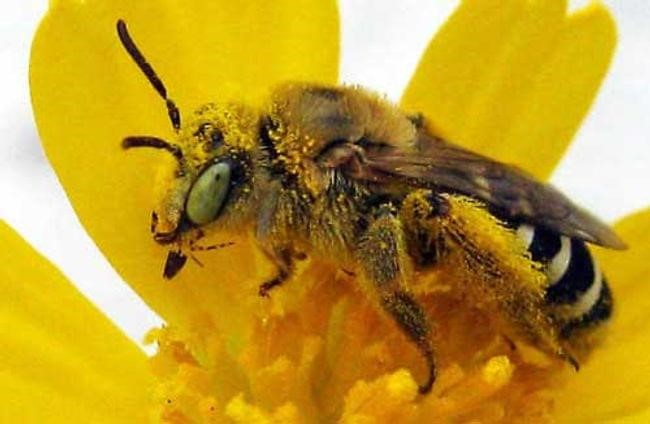

In [5]:
TEST_IMAGE = PIL.Image.open("inputimage/bee1.jpg")
# TEST_IMAGE = PIL.Image.open("inputimage/cauliflower1.jpg")
# TEST_IMAGE = PIL.Image.open("inputimage/peacock.jpg")
# TEST_IMAGE = PIL.Image.open("inputimage/car2.jpg")
# TEST_IMAGE = PIL.Image.open("inputimage/linx1.jpg")
display(TEST_IMAGE)
preprocessed_image = preprocess_image(np.asarray(TEST_IMAGE)/255.0)

## Model and Inference

In [6]:
model = models.resnet50(pretrained=True)
model.to(device)
model.eval()
yhat = model(preprocessed_image.clone().detach().to(device).requires_grad_(True))
probabilities = torch.nn.functional.softmax(yhat[0], dim=0)

with open("imagenet_classes.txt", "r") as f:
    categories = [s.strip() for s in f.readlines()]
# Show top categories per image
top5_prob, top5_catid = torch.topk(probabilities, 5)
for i in range(top5_prob.size(0)):
    cat_name = categories[top5_catid[i]]
    cat_name = cat_name[1+cat_name.find(':'):]
    print(cat_name, top5_prob[i].item())


 'bee', 0.6432002782821655
 'fly', 0.018821926787495613
 'isopod', 0.017938535660505295
 'ant, emmet, pismire', 0.017098085954785347
 'honeycomb', 0.01700481027364731


## Activations from the first layer

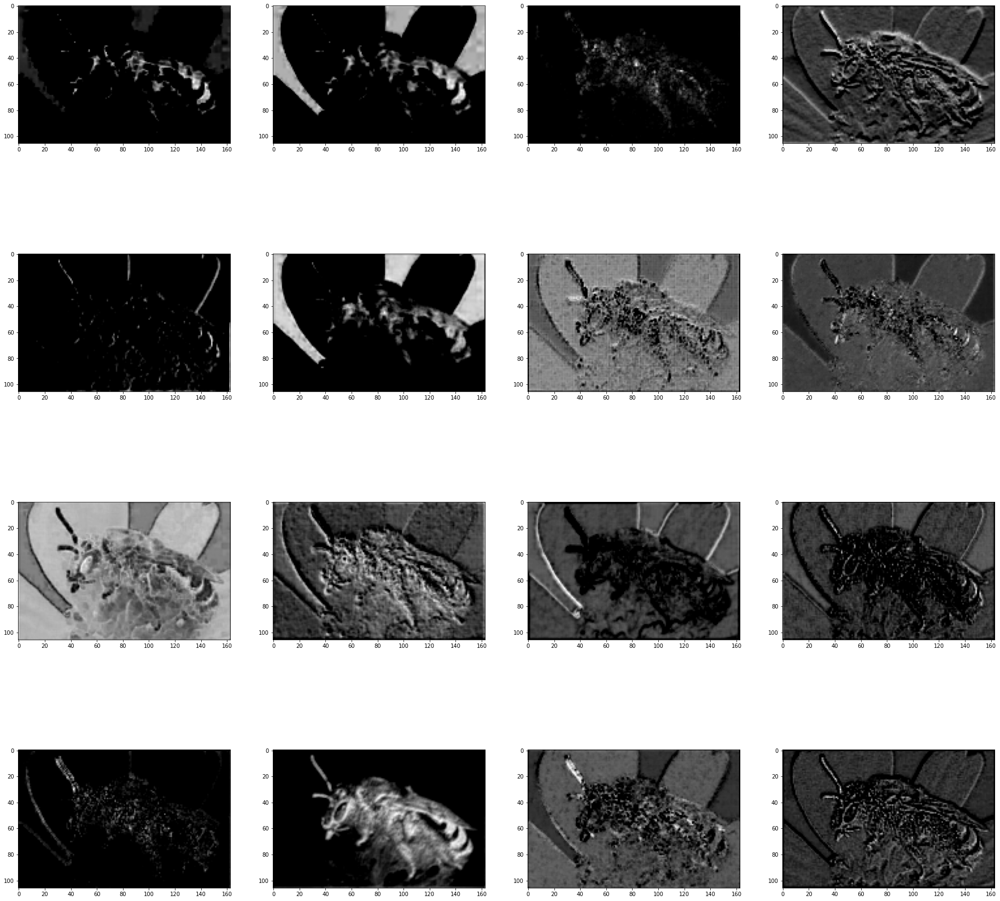

In [7]:
activation = {}
def get_activation(name):
    def hook(model, input, output):
        activation[name] = output.detach()
    return hook

def showActivations(layerName):
    k=0
    act = activation[layerName].squeeze()
    fig, axarr = plt.subplots(4,4,figsize=(32, 32))
    k=0
    for i in range(4):
        for j in range(4):
            axarr[i,j].imshow(act[k].detach().cpu().numpy(), cmap='gray')
            k+=1  
            
model.layer1[0].register_forward_hook(get_activation('conv0'))
data = preprocessed_image.clone().detach().to(device).requires_grad_(True)
data=data.to(device)
output = model(data)
showActivations('conv0')





## Activations from the second layer

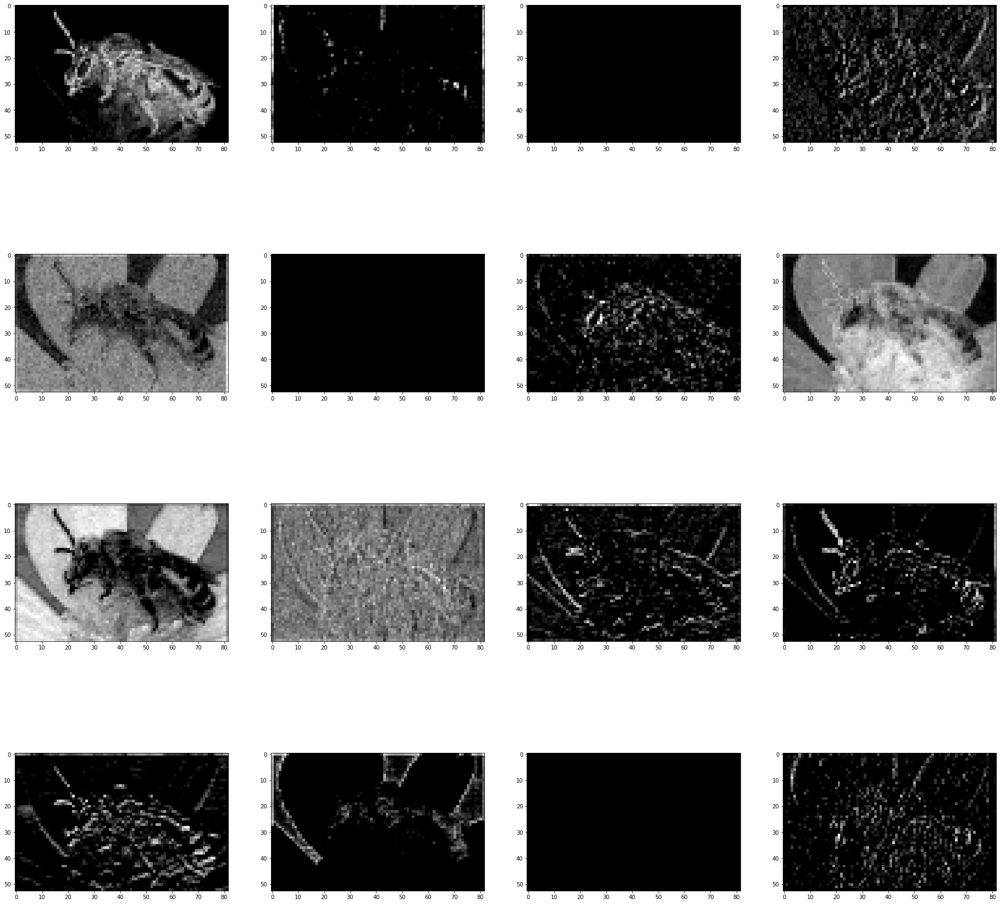

In [8]:
model.layer2[0].register_forward_hook(get_activation('conv2'))
data = preprocessed_image.clone().detach().to(device).requires_grad_(True)
data=data.to(device)
output = model(data)
showActivations('conv2')

## Filter Max

In [9]:
class ActivationsExtractor():    
    def __init__(self, module):
        self.hook = module.register_forward_hook(self.hook_fn)
        
    def hook_fn(self, module, input, output):
        self.features = output

    def close(self):
        self.hook.remove()

In [10]:
def visualizeFilter(activations, filter, lr, steps, size, upscales, upscale_factor):
    img = np.uint8(np.random.uniform(150, 180, (size, size, 3)))/255    

    for _ in range(upscales):                        
        img_var = preprocess_image(img).clone().detach().to(device).requires_grad_(True)
        optimizer = torch.optim.Adam([img_var], lr=lr, weight_decay=1e-6)

        for _ in range(steps):
            optimizer.zero_grad()
            model(img_var)
            loss = -activations.features[0, filter].mean()
            loss.backward()
            optimizer.step()

        img = deprocess_image(img_var.data.cpu().numpy()[0].transpose(1,2,0))
        output = img
        size = int(upscale_factor * size) 
        img = img.resize((size, size)) 
        img = img.filter(ImageFilter.BLUR)
        img = np.asarray(img) / 255.0
    display(output)

def getMainFilters(layer, k):
    activations = ActivationsExtractor(layer) # activations' hook
    _ = model(preprocessed_image.to(device)) # forward pass to collect activations
    average_activations_per_filters = [activations.features[0, i].mean().item() for i in range(activations.features.shape[1])]
    probs = torch.tensor(average_activations_per_filters)
    _ , idx = torch.topk(probs, k=k, axis=-1)
    return idx,activations


## Last Layer

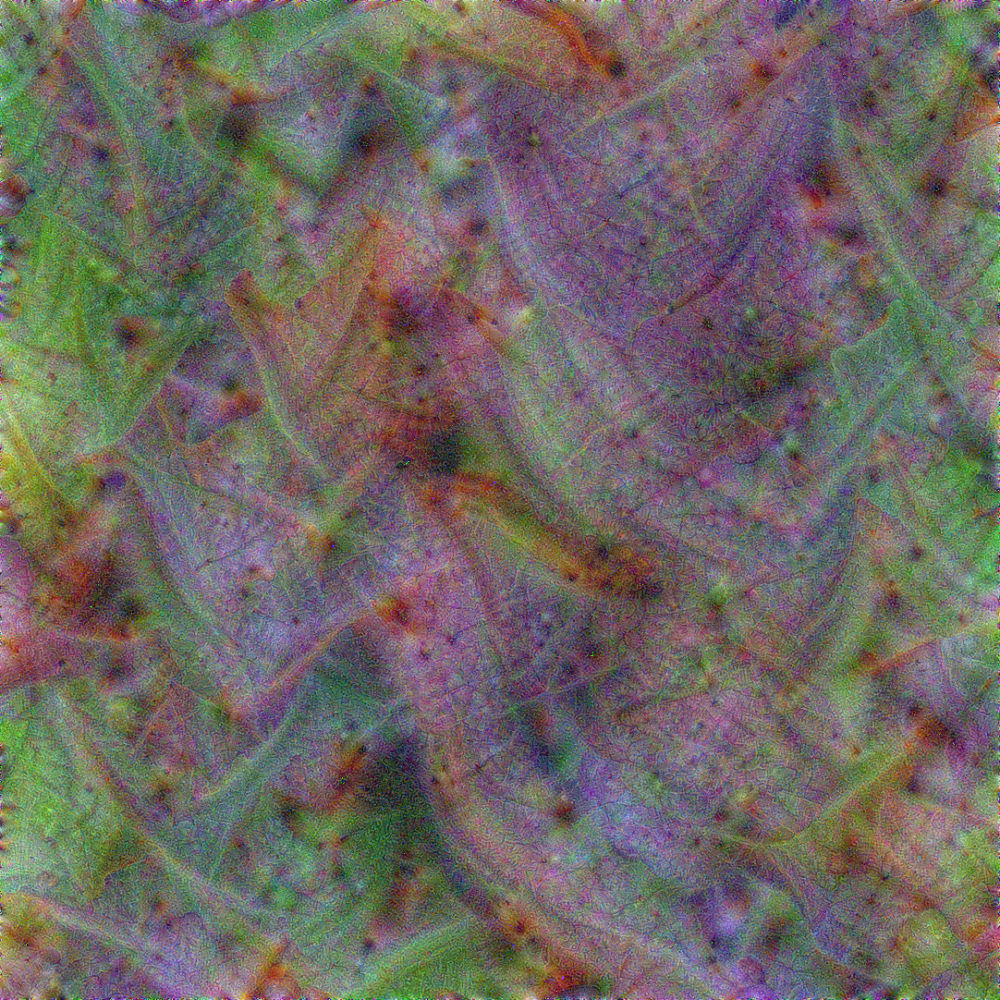

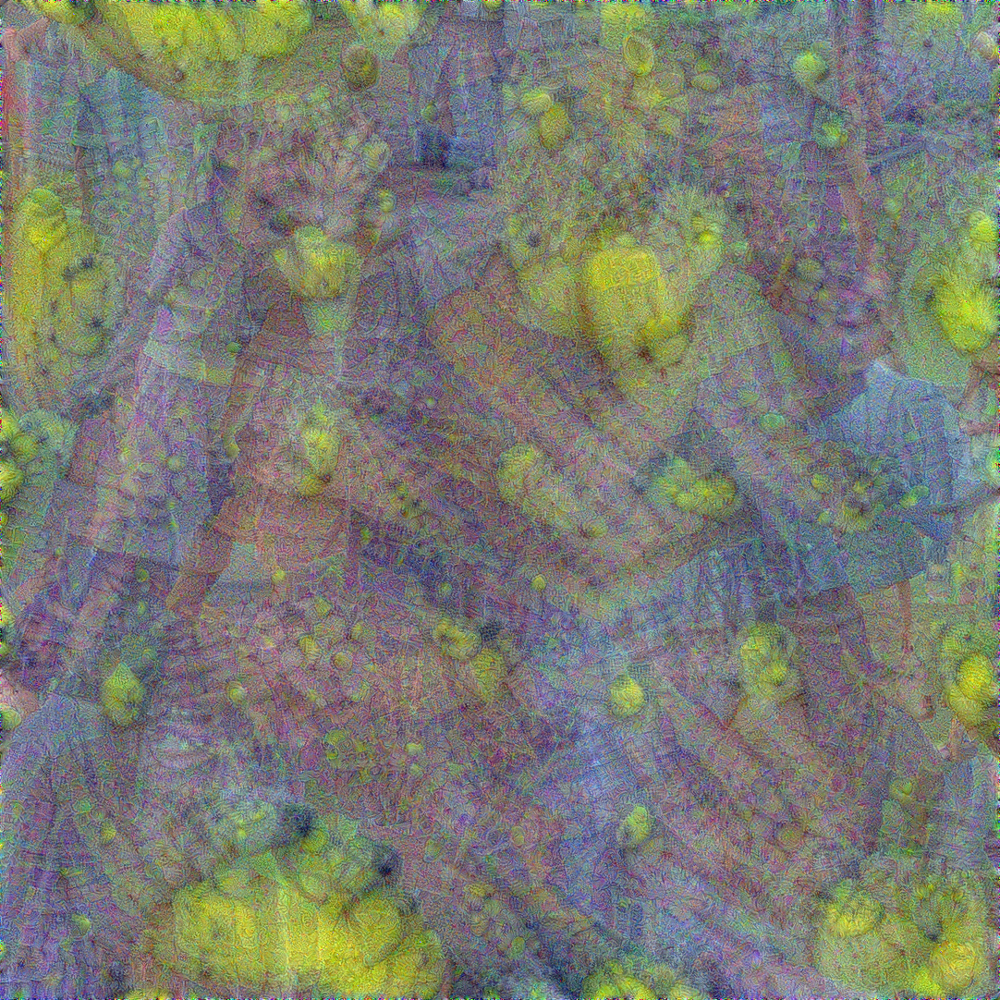

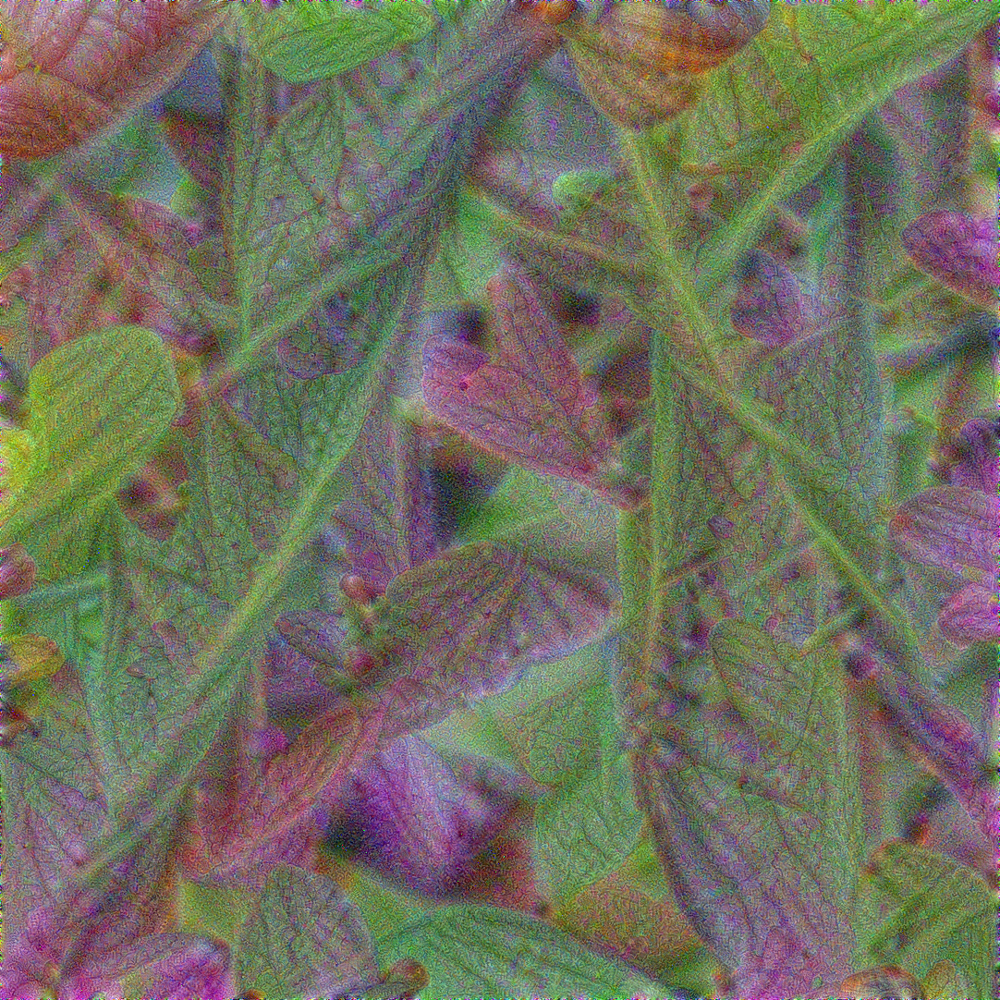

In [11]:
l = list(model.layer4[2].children())[6] # last non-output layer
filterList, activationList = getMainFilters(l, 3)
for f in filterList:
    visualizeFilter(activationList,
                f,
                lr=0.075,
                size=36,
                steps=15,
                upscales=20,
                upscale_factor=1.2)

## Second Layer

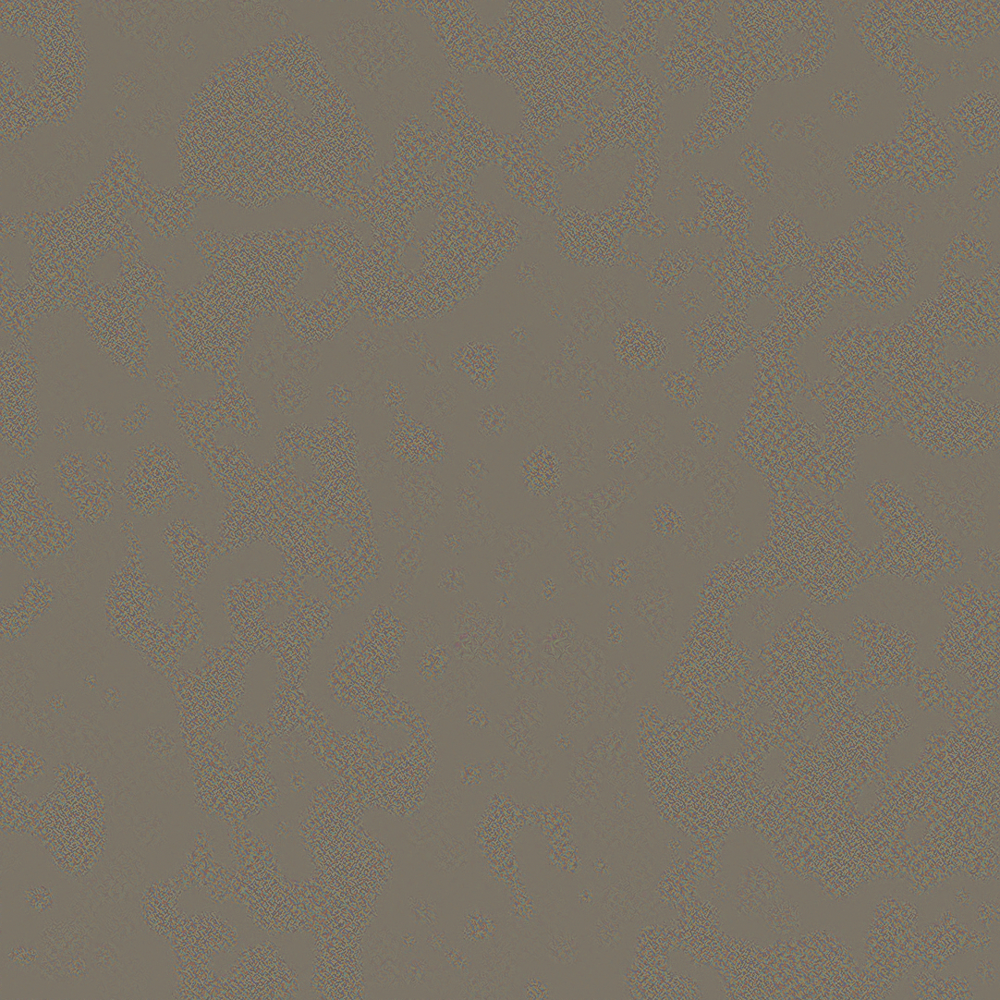

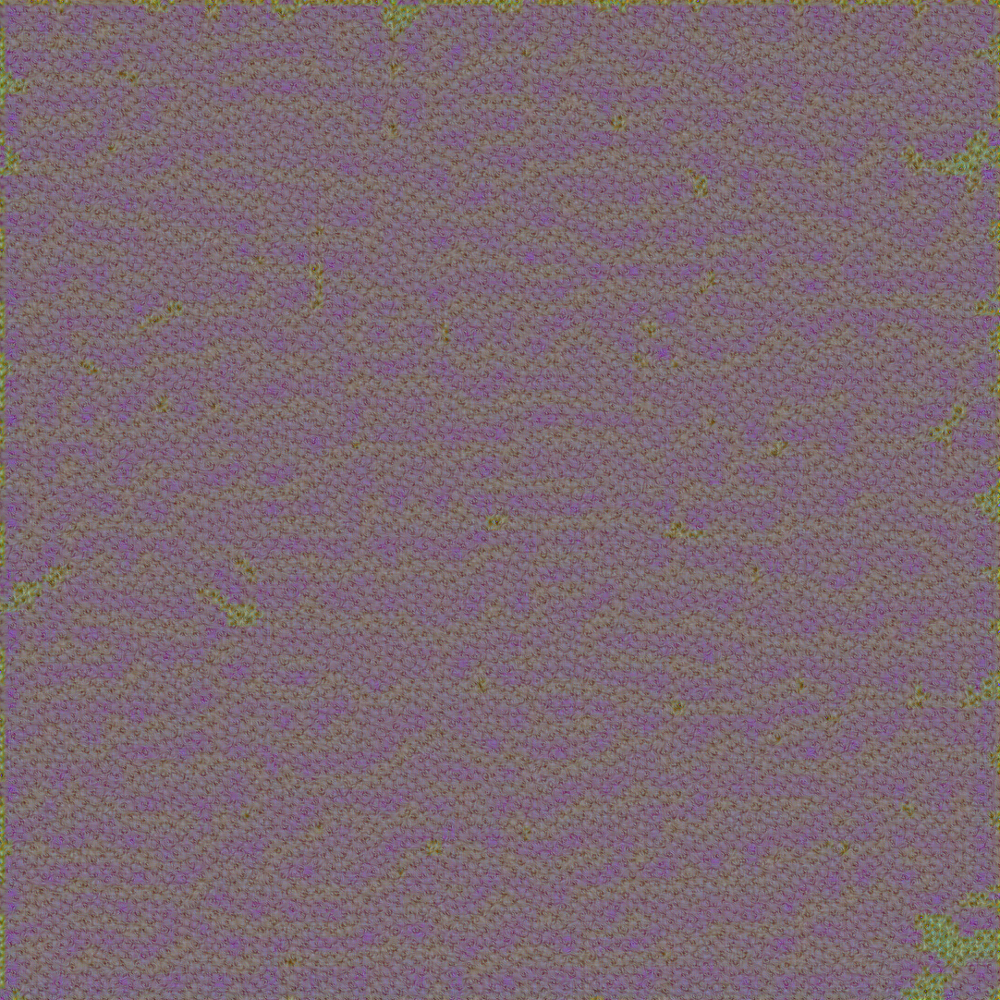

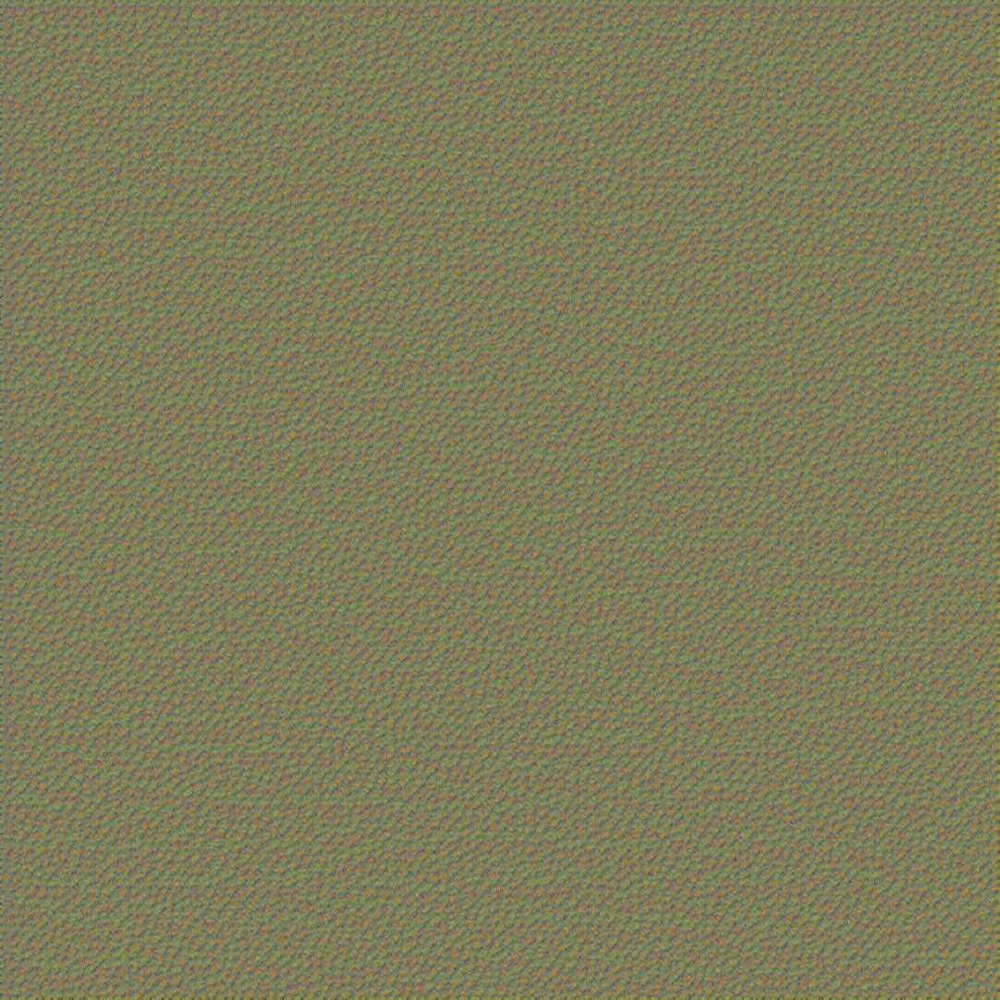

In [12]:
l = list(model.layer2[1].children())[6] # last non-output layer
filterList, activationList = getMainFilters(l, 3)
for f in filterList:
    visualizeFilter(activationList,
                f,
                lr=0.075,
                size=36,
                steps=15,
                upscales=20,
                upscale_factor=1.2)